In [ ]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from IPython.display import HTML
from ydata_profiling import ProfileReport
from autoviz.AutoViz_Class import AutoViz_Class
import sweetviz as sv
from phik import resources, report

from sklearn.preprocessing import StandardScaler
from cleanlab.outlier import OutOfDistribution

<h2><center>
  Loading and analyzing the Machine Failure Dataset
</h2>

In [6]:
df = pd.read_csv("Datasets/maintenance.csv")
df.head()

,UDI,Product ID,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,298.1,308.6,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,298.2,308.7,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,298.1,308.5,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,298.2,308.6,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,298.2,308.7,1408,40.0,9,0,0,0,0,0,0


In [7]:
df.shape

(10000, 14)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   UDI                      10000 non-null  int64  
 1   Product ID               10000 non-null  object 
 2   Type                     10000 non-null  object 
 3   Air temperature [K]      10000 non-null  float64
 4   Process temperature [K]  10000 non-null  float64
 5   Rotational speed [rpm]   10000 non-null  int64  
 6   Torque [Nm]              10000 non-null  float64
 7   Tool wear [min]          10000 non-null  int64  
 8   Machine failure          10000 non-null  int64  
 9   TWF                      10000 non-null  int64  
 10  HDF                      10000 non-null  int64  
 11  PWF                      10000 non-null  int64  
 12  OSF                      10000 non-null  int64  
 13  RNF                      10000 non-null  int64  
dtypes: float64(3), int64(9)

In [9]:
# Air temperature[k] and Process temperature [k] are im degrees Kelvin and for better understanding, I am going to convert them to degrees Celsius
df['Air temperature [K]'] =df['Air temperature [K]'] - 273.15
df['Process temperature [K]']= df['Process temperature [K]'] - 273.15
df = df.rename(columns={'Air temperature [K]': 'Air temperature [C]', 'Process temperature [K]': 'Process temperature [C]'})

In [10]:
df.head()

,UDI,Product ID,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,24.95,35.45,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,25.05,35.55,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,24.95,35.35,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,25.05,35.45,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,25.05,35.55,1408,40.0,9,0,0,0,0,0,0


In [11]:
# Loading the dataset with DataPrep library and creating a report
#profile= ProfileReport(df,title="Profiling Report", explorative=True)
#profile.to_notebook_iframe()  


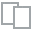
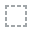
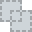
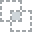
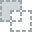
...
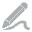
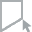
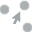
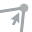
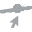

In [12]:
# Loading the maintenance_report.html file
HTML(filename="Datasets/maintenance_report.html")

## <span style="color: #20C997;">Personal Analysis</span>
The dataset has 14 variables and 10,000 rows, with no missing or duplicate values. 
#### The report shows: 
UDI is a unique identifier for each record.<br>
Air temperature [C] and Process temperature [C] have a normal distribution, because mean is not bigger than median and have short ranges.<br>
Rotation speed is skewed to the right, because mean is bigger than median and have a long range and kurtosis is bigger than 0.<br>
Type is a categorical column with 3 values and is imbalanced. L is more frequent than M and H.<br>
Rotational speed has normal distribution, because mean is not bigger than median and have short range and not skewed<br>
Torque has normal distribution.<br>
Tool Wear Failure has normal distribution, but has 120 zeros values, I have to search about it, do they have a meaning or are they missing values?<br>
<span style="color:red;">Now I got it, When machines use tools to shape or cut materials, those tools slowly wear out over time because of the heat, pressure, and friction.<br>
What I see from distribution, the minimum value is 0, and the maximum reaches 253 minutes, so zeros are meaningful because it shows that tool is not begun yet or tools are fresh.</span><br>
Rest of Columns which are categorical are Imbalanced. The 0 value is more frequent than 1. I need search about it, why it is like that?<br>
<span style="color:red;">Now I got it, because 0 means not failure so in real lifeF, failure of machines should be rare.</span>

What I got from scatter plot between TWF and Tool wear, both failures are detected in 203 min and 217 min, which means failures are not happened lower than 200 min.<br> Some tools got to higher than 217 min but failure is not happened, I think time alone is not the reason of failure, quality of tools or some others factors are more reasonable.<br><br>
Scatter plot and correlation heatmap show me that HDF is related more Air temperature and Torque than others but why than process temperature?,<br> I have to figure out about this!
<span style="color:red;"> What I leaned after googling, causes a process failure if the difference between the air temperature and the process temperature is less than 8.6 C.<br>
When machines release heat into the air, bigger the difference between the machine's heat and the air, the faster it cools.<br> If the air is already warm, it's harder for the machines to cool down because the heat does not have anywhere to go.
Why air temperature has more impact than process temperature because machines are designed to handle owm heat.</span><br>
HDF is related to Torque as well, HDF is happened when Torque is between 15 and 35 Nm, I am thinking why in this range, does it make scene, when machines are too high and too low, the HDF is 0.<br>
PWF(Power failure) is related with Torque and Rotational speed , what I see from scatter, when Torque is too high, PWF is 1.
<br><br>
OSF (OverStrain Failure) has correlation with Torque, Tool wear and  moderate correlation with Power failure, I got this from google:<br>
<span style="color:red;">OverStrain Failure (OSF): if the product of tool wear and torque exceeds 11,000 minimum Nm for the L product variant (12,000 for M, 13,000 for H), the process fails due to overstrain.<br>
Since both OSF and power failure are influenced by Torque, it makes sense.</span><br> 

Rotational Speed has strong negative correlation with Torque, which means <span style="color:red;"> when you need more force to turn something heavy or resist more load, the machine naturally slows down because it is working harder.<br> Itis like trading speed for strength, what I learned from scatter plot between torque and rotational speed. At the lower rotational speed, torque is vary widely which means machines are more used in lower speeds. <br> At higher speed and lower torque, distribution is narrow which means, using machines with high speed is not common.</span><br>

<br> HDF has stronger correlation with machine failure than TWF, PWF, OSF and RNF which means <span style="color:red;"> most of the time machine overheats. <br> As I mentioned previously HDF happens when the difference between air temperature and process temperature is less than 8.6 C, so cooling system does not work well or hot location.</span><br>
OSF is the second factor of machine failure, OSF happens  when the product of Torque and Tool Wear exceeds a specific threshold, depending on product quality (L, M, H).<br>
PWF is third cause of machine failure, PWF happens when the machine's power goes out of its safe range because of interaction of torque and rotational speed. <br>
TWF is the fourth cause of machine failure, TWF happens because tools wear out after a certain amount of use.<br>
UDI has correlation with both Air temperature and Process temperature, Since UDI is unique identifier, it can show processing over time, it has lower correlation with air temperature 

In [13]:
# Analyzing the dataset with Pandas Profiling 
profile = ProfileReport(df, title='Pandas Profiling Report')
# Display the report
profile.to_notebook_iframe()
# Saving the report to a file in HTML format
profile.to_file("Datasets/maintenance_Pandas_Profiling_report.html")
# show the report in the browser

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 14/14 [00:00<00:00, 280.95it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## <span style="color: #20C997;">Personal Analysis</span>
Pandas Profiling Report shows 18 alerts, some features have high correlation to each other, 6 categorical features are imbalanced.<brPandas profiling does not  provide new insights about the dataset what DataPrep library could not provide.


In [14]:
AV = AutoViz_Class()
# Visualize the dataset
dft = AV.AutoViz(df)

Shape of your Data Set loaded: (10000, 14)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    Number of Numeric Columns =  3
    Number of Integer-Categorical Columns =  2
    Number of String-Categorical Columns =  1
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  6
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  2
    Number of Columns to Delete =  0
    14 Predictors classified...
        2 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['UDI', 'Product ID']
To fix these data quality issues in the datas

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
UDI,int64,0.000000,100,1.000000,10000.000000,Possible ID column: drop before modeling step.
Product ID,object,0.000000,100,,,Possible ID column: drop before modeling step.
Type,object,0.000000,0,,,No issue
Air temperature [C],float64,0.000000,NA,22.150000,31.350000,No issue
Process temperature [C],float64,0.000000,NA,32.550000,40.650000,Column has a high correlation with ['Air temperature [C]']. Consider dropping one of them.
Rotational speed [rpm],int64,0.000000,9,1168.000000,2886.000000,"Column has 418 outliers greater than upper bound (1895.50) or lower than lower bound(1139.50). Cap them or remove them., Column has a high correlation with ['Torque [Nm]']. Consider dropping one of them."
Torque [Nm],float64,0.000000,NA,3.800000,76.600000,Column has 69 outliers greater than upper bound (67.20) or lower than lower bound(12.80). Cap them or remove them.
Tool wear [min],int64,0.000000,2,0.000000,253.000000,No issue
Machine failure,int64,0.000000,0,0.000000,1.000000,No issue
TWF,int64,0.000000,0,0.000000,1.000000,No issue


Number of All Scatter Plots = 6
All Plots done
Time to run AutoViz = 2 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


## <span style="color: #20C997;">Personal Analysis</span>
AutoViz shows that Rotational Speed has 418 outliers and has high correlation with Torque.<br>
Torque has 69 outliers. Air temperature has strong correlation with process temperature.

In [15]:
report = sv.analyze(df)
report.show_html("Datasets/maintenance_sweetviz_report.html")

                                             |          | [  0%]   00:00 -> (? left)

Report Datasets/maintenance_sweetviz_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


## <span style="color: #20C997;">Personal Analysis</span>
Sweetvis does not provide new insights what Data_Pred could not.

In [16]:
# Calculate the phik matrix
phik_overview = df.phik_matrix()
phik_overview

interval columns not set, guessing: ['UDI', 'Air temperature [C]', 'Process temperature [C]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]', 'Machine failure', 'TWF', 'HDF', 'PWF', 'OSF', 'RNF']


,UDI,Product ID,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
UDI,1.000000,1.0,0.000000,0.901887,0.847830,0.037301,0.032157,0.000000,0.238465,0.000000,0.392016,0.016920,0.000000,0.040020
Product ID,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Type,0.000000,1.0,1.000000,0.027828,0.022919,0.005016,0.000000,0.000000,0.020646,0.000000,0.002458,0.004130,0.034194,0.010312
Air temperature [C],0.901887,1.0,0.027828,1.000000,0.923235,0.037658,0.039935,0.111049,0.160864,0.000000,0.264614,0.000000,0.000000,0.000000
Process temperature [C],0.847830,1.0,0.022919,0.923235,1.000000,0.000000,0.029331,0.131704,0.087284,0.000000,0.135163,0.019043,0.000000,0.017601
Rotational speed [rpm],0.037301,1.0,0.005016,0.037658,0.000000,1.000000,0.937916,0.000000,0.448734,0.000000,0.237838,0.658560,0.191970,0.000000
Torque [Nm],0.032157,1.0,0.000000,0.039935,0.029331,0.937916,1.000000,0.000000,0.585491,0.017063,0.227078,0.845246,0.356773,0.021276
Tool wear [min],0.000000,1.0,0.000000,0.111049,0.131704,0.000000,0.000000,1.000000,0.278363,0.330997,0.000000,0.000000,0.345249,0.000000
Machine failure,0.238465,1.0,0.020646,0.160864,0.087284,0.448734,0.585491,0.278363,1.000000,0.534104,0.783517,0.728856,0.737738,0.000000
TWF,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.017063,0.330997,0.534104,1.000000,0.000000,0.000000,0.045648,0.015395


## <span style="color: #20C997;">Personal Analysis</span>
Phik shows higher correlation between PWF, Torque and Rotational speed than Data_Prep.<br>
Rotational speed has strong correlation  with Torque, Machine Failure and Power failure.<br>
Torque has strong correlation Rotational Speed, Machine Failure, power failure and overstrain failure.<br>
Tool wear has correlation with overstrain failure, WTF and Machine Failure.<br>
For Machine Failure, Phik shows stronger correlation with HDF(0.78) while Data Prep showed 0.58, and for others Failure modes is same.

In [17]:
# UDI and Product ID are not meaningful, so I will drop them
df = df.drop(columns=['UDI', 'Product ID'], axis=1)
df.head()

,Type,Air temperature [C],Process temperature [C],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,M,24.95,35.45,1551,42.8,0,0,0,0,0,0,0
1,L,25.05,35.55,1408,46.3,3,0,0,0,0,0,0
2,L,24.95,35.35,1498,49.4,5,0,0,0,0,0,0
3,L,25.05,35.45,1433,39.5,7,0,0,0,0,0,0
4,L,25.05,35.55,1408,40.0,9,0,0,0,0,0,0


In [18]:
# In DS, I have many columns of failure, the 1 class is very less than 0 class. that is realistic 
# Ok, so what if I find the rate of failure for each column 
failure_columns = ["Machine failure","TWF","HDF","PWF","OSF","RNF"]

for column in failure_columns:
    if column in df.columns:
        failure_count= int(df[column].sum())
        failure_percentage =(failure_count/len(df))*100
        print(f"\n{column}:")
        print(f"Failure:{failure_count} ({failure_percentage:.1f}%)")


Machine failure:
Failure:339 (3.4%)

TWF:
Failure:46 (0.5%)

HDF:
Failure:115 (1.1%)

PWF:
Failure:95 (0.9%)

OSF:
Failure:98 (1.0%)

RNF:
Failure:19 (0.2%)


In [19]:
# Interesting, Since Machine failure is overall failure flag.
# But overall failure number does not show the sum of other failure columns.
# 46+115+95+98+19 = 373 
# Machine failure is 339.

In [20]:
# So I am going to compare Machine failure with other failure columns. 
failure_column = ["TWF","HDF","PWF","OSF","RNF"]
class_failure = df[failure_column].any(axis=1)
machine_failure =df["Machine failure"].astype(int)

true = class_failure &(machine_failure== 0)   
false =(~class_failure) &(machine_failure==1) 
print(df.loc[true | false,["Machine failure"]+failure_column])
# 27 rows have inconsistent label 

      Machine failure  TWF  HDF  PWF  OSF  RNF
1221         0          0    0    0    0    1 
1302         0          0    0    0    0    1 
1437         1          0    0    0    0    0 
1748         0          0    0    0    0    1 
2072         0          0    0    0    0    1 
2559         0          0    0    0    0    1 
2749         1          0    0    0    0    0 
3065         0          0    0    0    0    1 
3452         0          0    0    0    0    1 
4044         1          0    0    0    0    0 
4684         1          0    0    0    0    0 
5471         0          0    0    0    0    1 
5489         0          0    0    0    0    1 
5495         0          0    0    0    0    1 
5509         0          0    0    0    0    1 
5536         1          0    0    0    0    0 
5553         0          0    0    0    0    1 
5639         0          0    0    0    0    1 
5941         1          0    0    0    0    0 
6091         0          0    0    0    0    1 
6478         

In [21]:
# Now, if I can a create table for failure patterns, to see the operation conditions when failure happens.
# In my personal analysis cell, I explained that one of failure causes, air temperature and process temperature difference.
# higher rmp automatically effects the power
# overload and old tool are cause of OSF.

# I am going  analyze temperature difference
# Mechanical power in Watts, for I ask ChatGPT: How to calculate the mechanical power from Torque [Nm] and Rotational speed [rpm]?
# I got the concept from ChatGPT
condition_table = df.assign(
    temp_diff_C=df["Process temperature [C]"]-df["Air temperature [C]"],
    power_Watts=df["Torque [Nm]"]*df["Rotational speed [rpm]"]*(2*np.pi/60),
    torque_wear=df["Torque [Nm]"]*df["Tool wear [min]"])

failure_columns =["Machine failure","TWF","HDF","PWF","OSF","RNF"]
sensors = ["temp_diff_C","Rotational speed [rpm]","Torque [Nm]","Tool wear [min]","power_Watts","torque_wear"]

# Creating a summary table to show failure
rows =[]
for class_1 in failure_columns:
    class_1_container= condition_table[condition_table[class_1]== 1]
    rows.append([class_1]+list(class_1_container[sensors].median().round(1).values))

summary_table= pd.DataFrame(rows, columns=["Failure_type"]+[column+"_median" for column in sensors]).set_index("Failure_type")
summary_table
# I used QWEN MAX 3 to debug the code.

,temp_diff_C_median,Rotational speed [rpm]_median,Torque [Nm]_median,Tool wear [min]_median,power_Watts_median,torque_wear_median
Failure_type,,,,,,
Machine failure,9.3,1365.0,53.7,165.0,7611.4,7681.8
TWF,9.6,1516.0,37.8,214.5,6021.2,7982.8
HDF,8.3,1346.0,52.6,106.0,7343.5,5580.0
PWF,9.7,1386.0,63.6,100.0,9100.4,3608.8
OSF,10.0,1360.5,57.7,207.0,8175.3,11689.4
RNF,9.6,1481.0,45.7,144.0,6826.9,6124.8


In [22]:
# What I can see in the table above:
# When the machine is overloaded the temperature difference gets higher.
# TWF accous when the tool wars is over 2014 minutes.
# When the mechanical power is around 9100 Wat happnes.

In [23]:
# Let's find the normal condition when verything is wokring smoothly
Copy_table = summary_table.copy()
Copy_table.columns = [column.replace("_median", "") for column in Copy_table.columns]

normal_operation= condition_table.loc[condition_table["Machine failure"] == 0,Copy_table.columns].median()

normal_condition = ((Copy_table/normal_operation-1)*100).round(1)
normal_condition

,temp_diff_C,Rotational speed [rpm],Torque [Nm],Tool wear [min],power_Watts,torque_wear
Failure_type,,,,,,
Machine failure,-5.1,-9.4,34.6,54.2,21.9,94.3
TWF,-2.0,0.6,-5.3,100.5,-3.6,102.0
HDF,-15.3,-10.7,31.8,-0.9,17.6,41.2
PWF,-1.0,-8.0,59.4,-6.5,45.8,-8.7
OSF,2.0,-9.7,44.6,93.5,31.0,195.7
RNF,-2.0,-1.7,14.5,34.6,9.4,54.9


In [ ]:
# In Normal operation: 
# For HDH, the temperature difference -15% lower
# lower speed and torque is higher
# PWF is mostly torque driven power overload, not speeddriven and not wear driven.

<h3><center>Imbalanced classes<h3>

In [ ]:
# failure types are imbalanced, most of classes are 0.
#  So to handle the imbalance,  there are many ways: oversampling, undersampling, and class weighting.
# based on my experience, class weighting because you dont change the data distribution and the actual data points.

categorical_columns = ["Machine failure","TWF","HDF","PWF","OSF","RNF"]
total_rows = len(df)

rows =[]
for classes in categorical_columns:
    failure = int(df[classes].sum())
    non_failure= total_rows - failure
    failure_rate = failure/total_rows*100
    failure_weight = non_failure/failure 
    rows.append([classes,failure,non_failure, round(failure_rate,1),round(failure_weight, 1)])
imbalance_table =pd.DataFrame(rows,columns=["columns","failure","non_failure","failure_%", "non_failure_weight"]).set_index("columns")

imbalance_table

,failure,non_failure,failure_%,non_failure_weight
columns,,,,
Machine failure,339,9661,3.4,28.5
TWF,46,9954,0.5,216.4
HDF,115,9885,1.1,86.0
PWF,95,9905,0.9,104.3
OSF,98,9902,1.0,101.0
RNF,19,9981,0.2,525.3


<h3><center>Outlier<h3>

In [34]:
# Now, in this cell, I am going to use detect outliers.
# To detect outliers,  there is many methods, I am going to use Nearest Neighbor method.
continues_columns = ["Air temperature [C]", "Process temperature [C]", "Rotational speed [rpm]", "Torque [Nm]", "Tool wear [min]"]
numerical_features = df[continues_columns].to_numpy()
numerical_scaled  = StandardScaler().fit_transform(numerical_features)

nearest_neighbor = OutOfDistribution()
df["outlier_score"] = nearest_neighbor.fit_score(features=numerical_scaled)

threshold = df["outlier_score"].quantile(0.95)
df["is_outlier"] =(df["outlier_score"]>= threshold).astype(int)
print("Outliers count:",int(df["is_outlier"].sum()))

Fitting OOD estimator based on provided features ...
Outliers count: 500


In [ ]:
# In previous cell, I found 27 rows are noisy and to use this DS as training data for classify the machine failure, We have to drop other failure types
# Because that is kind of cheaing code for the model to learn the failure patterns.
# I going to use temperature difference, instead of Air temperature and Process temperature.
# I will keep the power column, that is meaningful for PWF.

In [ ]:
# To understand the columns, their values, and some technical details, I used QWEN MAX 3.